<a href="https://colab.research.google.com/github/rioseleng09/pmacp05-V3/blob/main/PMA_CP05_V1_FINAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**ES234422 - Predictive Modelling and Analytics**

# **Guided Capstone Project 05**

**Team Number: 2**

**Team Member:**

1.   5026211191 - Rio Rezky Seleng
2.   SID - Full Name
3.   SID - Full Name

In [ ]:
!pip install matplotlib

In [ ]:
!pip install mahotas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 17.0 MB/s eta 0:00:00


In [ ]:
!pip install scikit-learn

In [ ]:
!pip install keras

In [ ]:
!pip install tensorflow

In [ ]:
import mahotas as mh
import seaborn as sns
from matplotlib import pyplot as plt
from glob import glob
import os
import numpy as np
import pandas as pd

from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

#Classifiers
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [ ]:
IMM_SIZE = 224

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
def get_data(folder):
    class_names = [f for f in os.listdir(folder) if not f.startswith('.')] # ctreate a list of SubFolders
    data = []
    print(class_names)
    for t, f in enumerate(class_names):
        images = glob(folder + "/" + f + "/*") # create a list of files
        print("Downloading: ", f)
        fig = plt.figure(figsize = (50,50))
        for im_n, im in enumerate(images):
            plt.gray() # set grey colormap of images
            image = mh.imread(im)
            if len(image.shape) > 2:
                image = mh.resize_to(image, [IMM_SIZE, IMM_SIZE, image.shape[2]]) # resize of RGB and png images
            else:
                image = mh.resize_to(image, [IMM_SIZE, IMM_SIZE]) # resize of grey images
            if len(image.shape) > 2:
                image = mh.colors.rgb2grey(image[:,:,:3], dtype = np.uint8)  # change of colormap of images alpha chanel delete
            plt.subplot(int(len(images)/5)+1,5,im_n+1) # create a table of images
            plt.imshow(image)
            data.append([image, f])
        plt.show()

    return np.array(data)

In [ ]:
!pip install numpy --upgrade
!pip install mahotas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.2/18.2 MB 52.1 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.23.5
    Uninstalling numpy-1.23.5:
      Successfully uninstalled numpy-1.23.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires kaleido, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.
cupy-cuda11x 11.0.0 requires numpy<1.26,>=1.20, but you have numpy 1.26.2 which is incompatible.


['Covid', 'Normal', 'Viral Pneumonia']
Downloading:  Covid


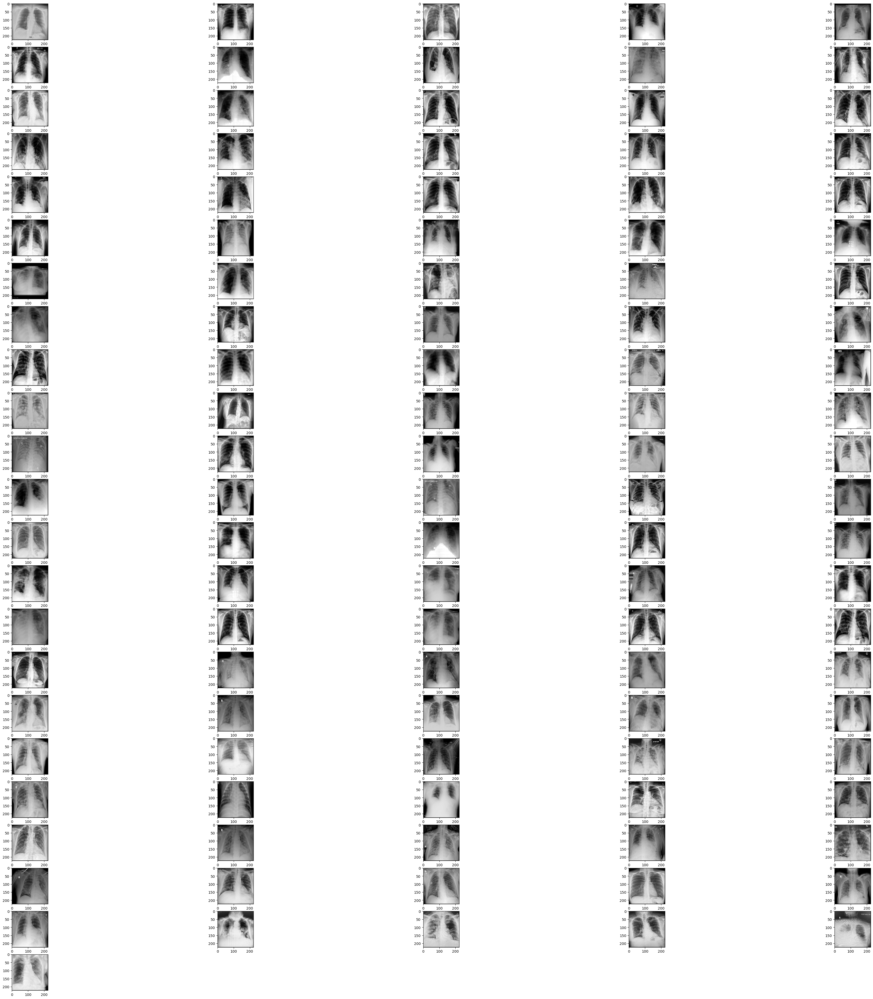

Downloading:  Normal


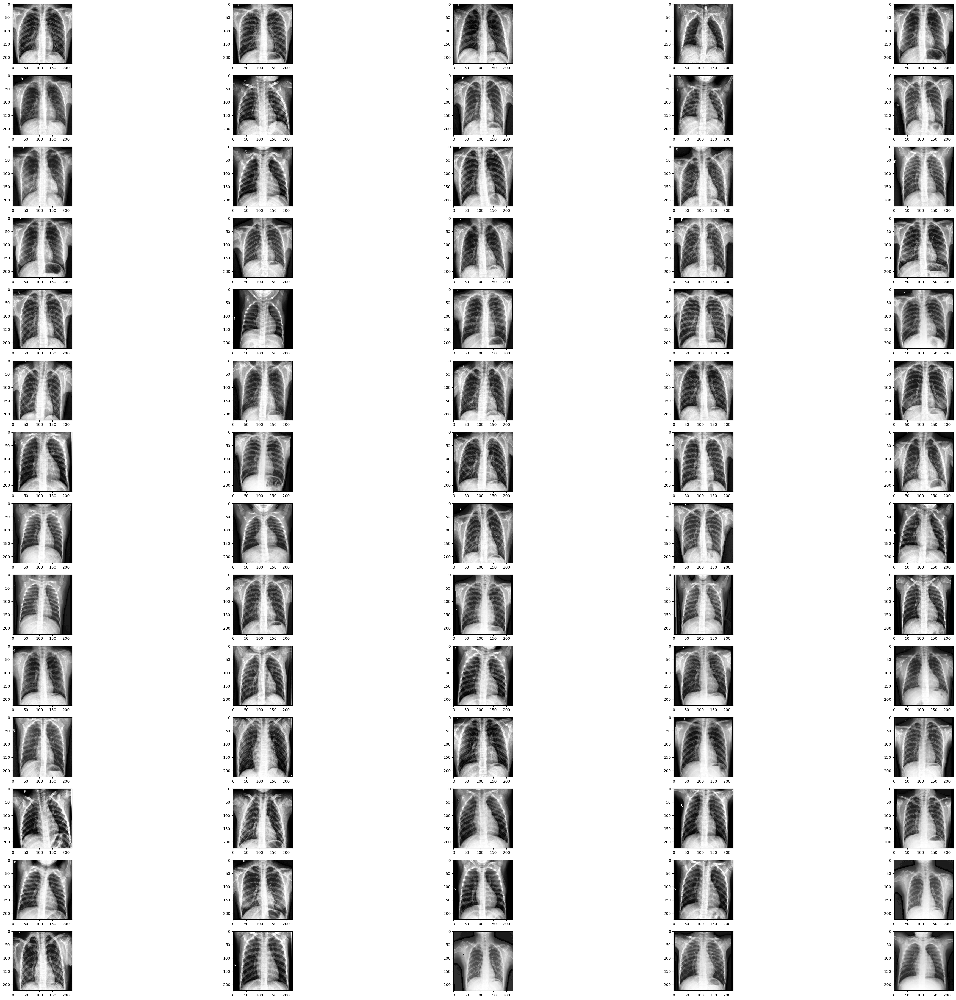

Downloading:  Viral Pneumonia


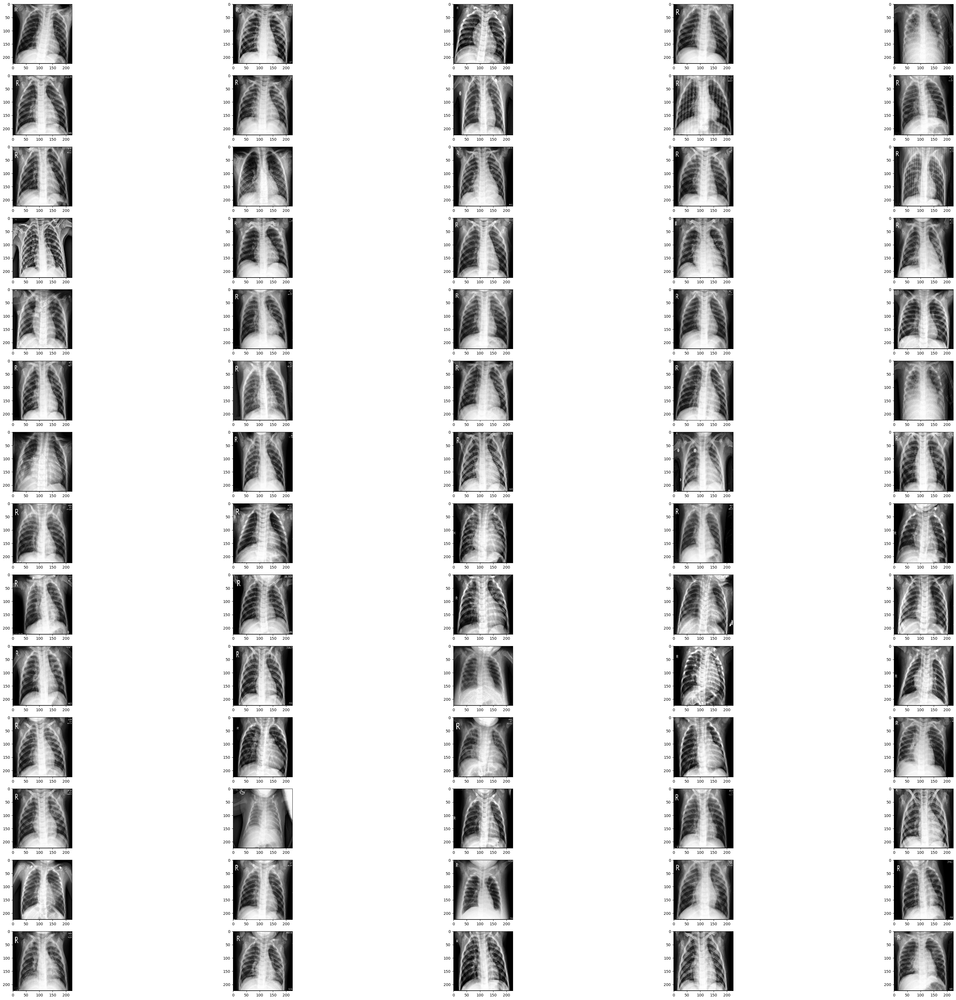

<ipython-input-9-6a5635d89208>:23: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(data)


['Viral Pneumonia', 'Normal', 'Covid']
Downloading:  Viral Pneumonia


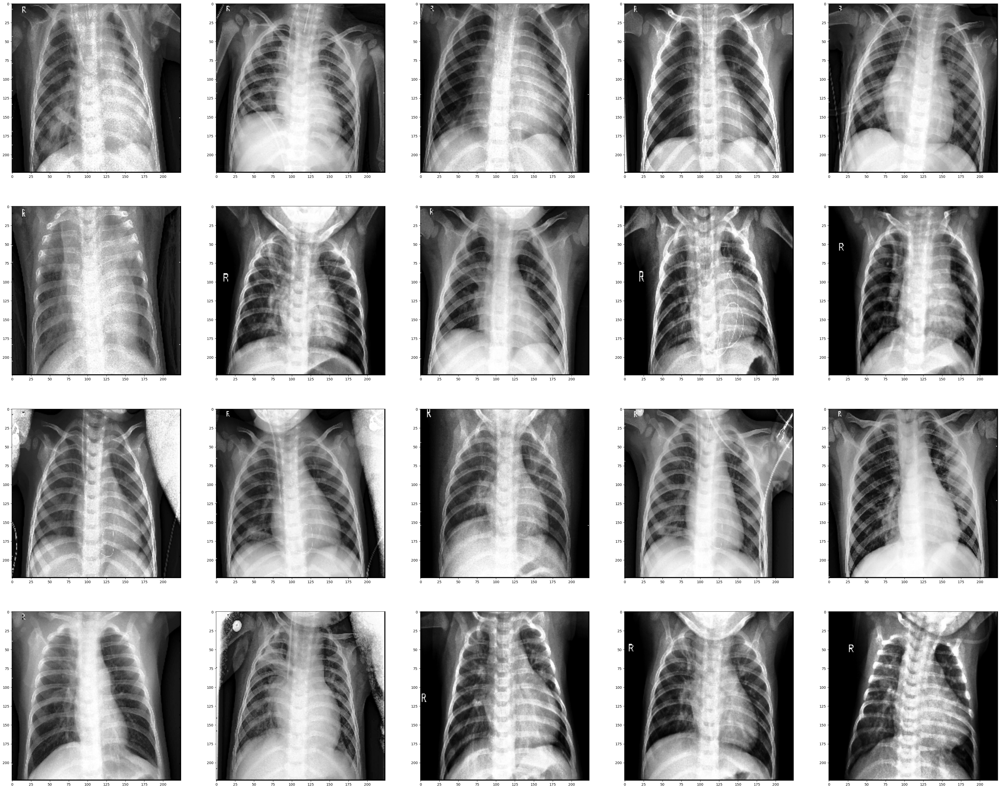

Downloading:  Normal


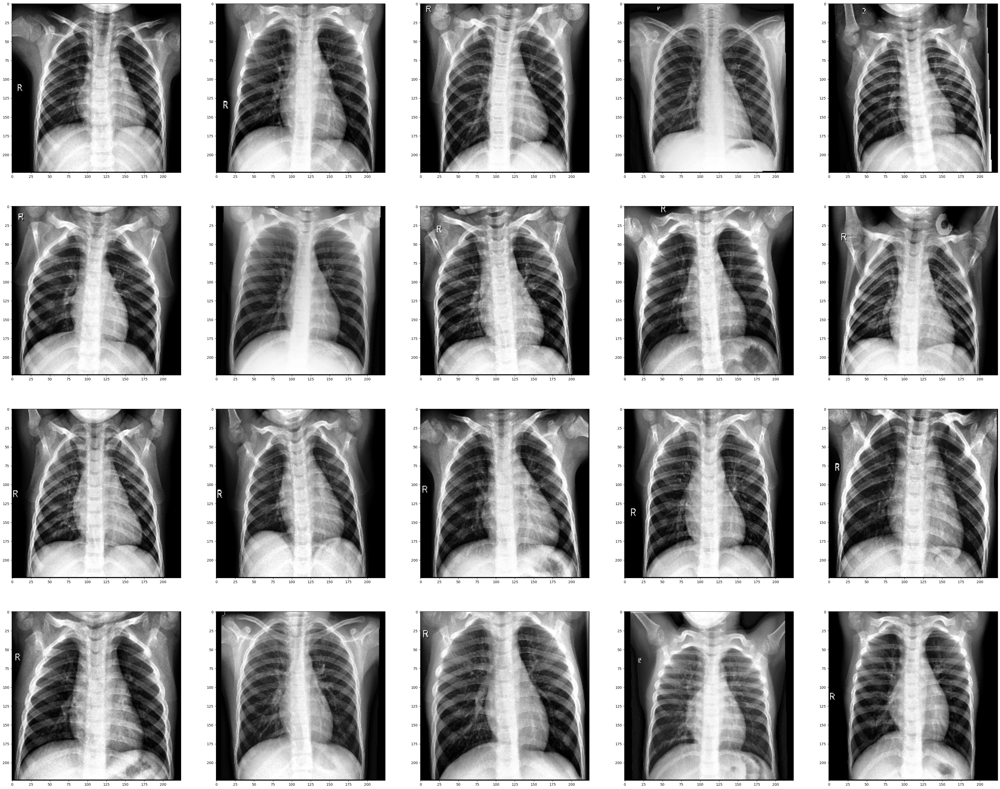

Downloading:  Covid


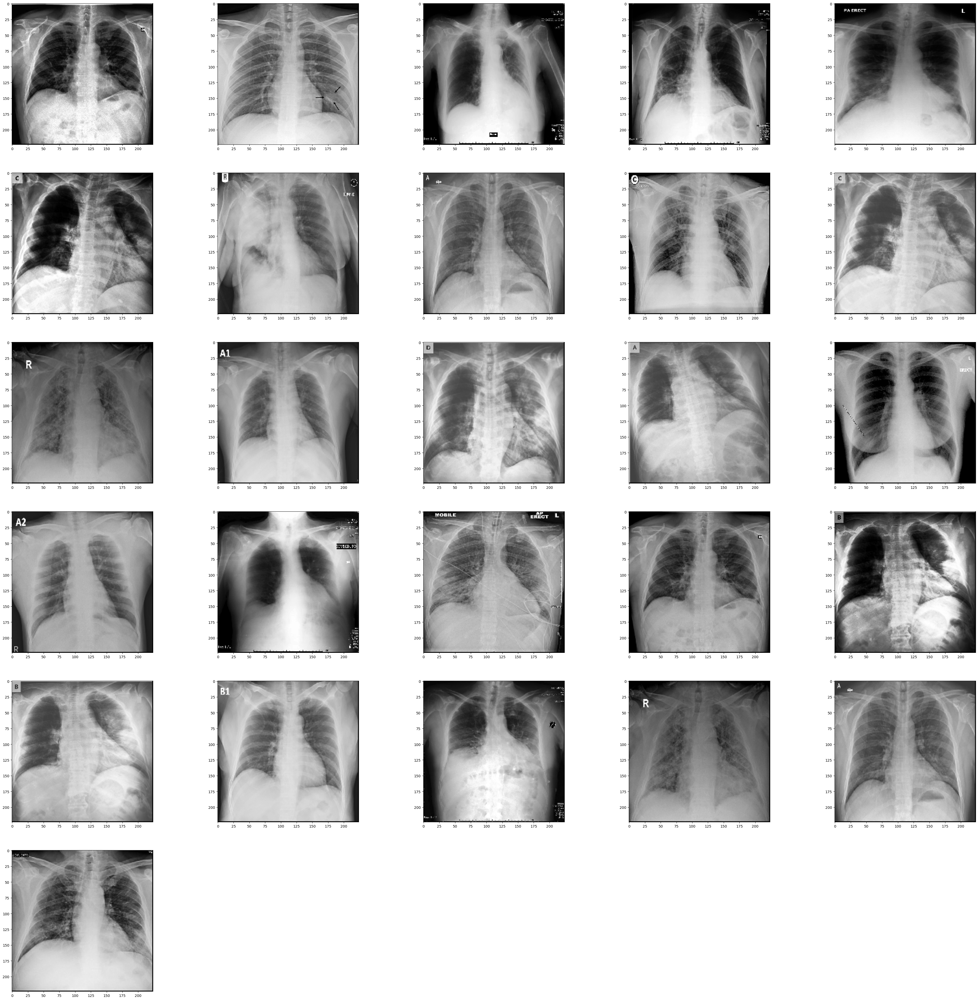

In [ ]:
d = "/content/drive/MyDrive/Covid19-dataset/train"
train = get_data(d)

d = "/content/drive/MyDrive/Covid19-dataset/test"
val = get_data(d)

In [ ]:
print("Train shape", train.shape) # Size of the training DataSet
print("Test shape", val.shape) # Size of the test DataSet
print("Image size", train[0][0].shape) # Size of image

Train shape (251, 2)
Test shape (66, 2)
Image size (224, 224)


<Axes: xlabel='Category', ylabel='count'>

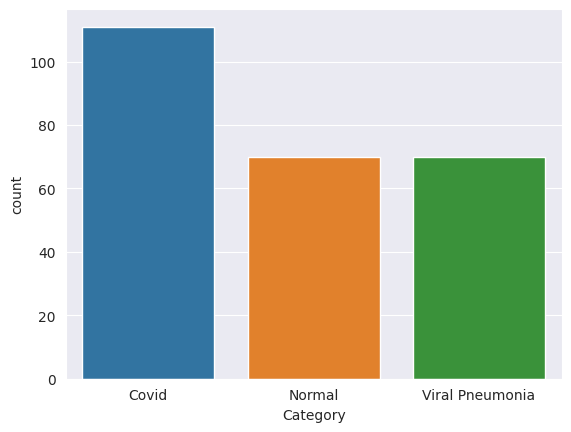

In [ ]:
import seaborn as sns
import pandas as pd

df = pd.DataFrame(train, columns=['Index', 'Category'])

sns.set_style('darkgrid')
sns.countplot(x='Category', data=df)

Text(0.5, 1.0, 'Viral Pneumonia')

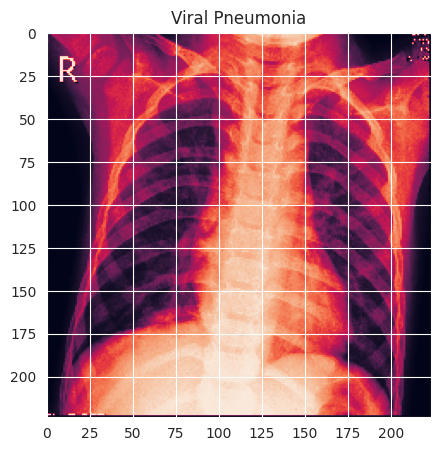

In [ ]:
plt.figure(figsize = (5,5))
plt.imshow(train[np.where(train[:,1] == 'Viral Pneumonia')[0][0]][0])
plt.title('Viral Pneumonia')

Text(0.5, 1.0, 'Covid')

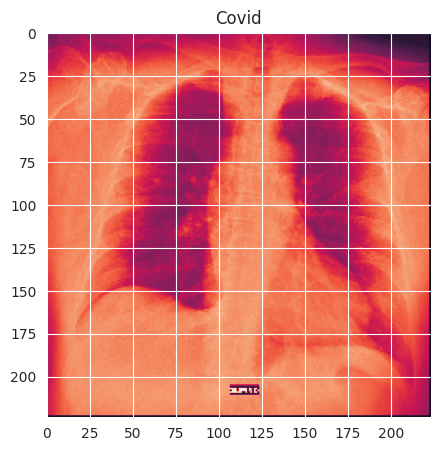

In [ ]:
plt.figure(figsize = (5,5))
plt.imshow(train[np.where(train[:,1] == 'Covid')[0][0]][0])
plt.title('Covid')

In [ ]:
def create_features(data):
    features = []
    labels = []
    for image, label in data:
        features.append(mh.features.haralick(image).ravel())
        labels.append(label)
    features = np.array(features)
    labels = np.array(labels)
    return (features, labels)

In [ ]:
features_train, labels_train = create_features(train)
features_test, labels_test = create_features(val)

In [ ]:
import keras
from keras.models import Sequential
from keras.layers import Dense, Conv2D , MaxPool2D , Flatten , Dropout
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
import tensorflow as tf
from sklearn.metrics import classification_report,confusion_matrix

In [ ]:
x_train = []
y_train = []
x_val = []
y_val = []

for feature, label in train:
    x_train.append(feature)
    y_train.append(label)

for feature, label in val:
    x_val.append(feature)
    y_val.append(label)

# Normalize the data
x_train = np.array(x_train) / 255
x_val = np.array(x_val) / 255

# Reshaping input images
x_train = x_train.reshape(-1, IMM_SIZE, IMM_SIZE, 1)
x_val = x_val.reshape(-1, IMM_SIZE, IMM_SIZE, 1)

# Creating a dictionary of clases
lab = {}
for i, l in enumerate(set(y_train)):
    lab[l] = i


y_train = np.array([lab[l] for l in y_train])
y_val = np.array([lab[l] for l in y_val])

In [ ]:
print("Shape of the input DataSet:", x_train.shape)
print("Shape of the output DataSet:", y_train.shape)
print("Dictionary of classes:", lab)

Shape of the input DataSet: (251, 224, 224, 1)
Shape of the output DataSet: (251,)
Dictionary of classes: {'Viral Pneumonia': 0, 'Covid': 1, 'Normal': 2}


In [ ]:
datagen = ImageDataGenerator(
        featurewise_center=False,  # set input mean to 0 over the dataset
        samplewise_center=False,  # set each sample mean to 0
        featurewise_std_normalization=False,  # divide inputs by std of the dataset
        samplewise_std_normalization=False,  # divide each input by its std
        zca_whitening=False,  # apply ZCA whitening
        rotation_range = 30,  # randomly rotate images in the range (degrees, 0 to 180)
        zoom_range = 0.2, # Randomly zoom image
        width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
        height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
        horizontal_flip = True,  # randomly flip images
        vertical_flip=False)  # randomly flip images


datagen.fit(x_train)

In [ ]:
model = Sequential()
model.add(Conv2D(32,1,padding="same", activation="relu", input_shape=(IMM_SIZE,IMM_SIZE,1)))
model.add(MaxPool2D())

#maxpool2D layer to reduces the size of patterns found in the images. This layer helps the model to foucuses only on the most important features
model.add(Conv2D(32, 1, padding="same", activation="relu"))
model.add(MaxPool2D())

#dropout layer. Which is used to randomly "drop out" The unnecessary informatiom durung training. This prevents the model from ovrfitting during training
model.add(Conv2D(64, 1, padding="same", activation="relu"))
model.add(MaxPool2D())
model.add(Dropout(0.4))

#The next is flatten layer. This layer converts the input into 1D array which is then will be throw into dense layer.
model.add(Flatten())
model.add(Dense(128,activation="relu"))
#The last i dense layer, which have 3 neurons and this layer will help to classify the three classes
model.add(Dense(3, activation="softmax"))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      64        
                                                                 
 max_pooling2d (MaxPooling2  (None, 112, 112, 32)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 32)      1056      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 56, 56, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 56, 56, 64)        2112      
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 28, 28, 64)        0

In [ ]:
opt = Adam(lr=0.000001)
model.compile(optimizer = opt , loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True) , metrics = ['accuracy'])

In [ ]:
fitting = True
fitting_save = True
epochs = 8

import pickle

if fitting:
    history = model.fit(x_train,y_train,epochs = epochs , validation_data = (x_val, y_val), shuffle = True)
    if fitting_save:
    # serialize model to JSON
        model_json = model.to_json()
        with open("model.json", "w") as json_file:
            json_file.write(model_json)
        # serialize weights to HDF5
        model.save_weights("model.h5")
        print("Saved model to disk")
        with open('history.pickle', 'wb') as f:
            pickle.dump(history.history, f)
        with open('lab.pickle', 'wb') as f:
            pickle.dump(lab, f)
# load model
from keras.models import model_from_json
json_file = open('model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
model = model_from_json(loaded_model_json)
# load weights into a new model
model.load_weights("model.h5")
with open('history.pickle', 'rb') as f:
    history = pickle.load(f)
print("Loaded model from disk")

Epoch 1/8


/usr/local/lib/python3.10/dist-packages/keras/src/backend.py:5729: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Softmax activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


8/8 [==============================] - 21s 2s/step - loss: 1.0787 - accuracy: 0.5020 - val_loss: 0.8741 - val_accuracy: 0.5909
Epoch 2/8
8/8 [==============================] - 14s 2s/step - loss: 0.5453 - accuracy: 0.7809 - val_loss: 0.7195 - val_accuracy: 0.6667
Epoch 3/8
8/8 [==============================] - 7s 936ms/step - loss: 0.3946 - accuracy: 0.8645 - val_loss: 0.6981 - val_accuracy: 0.7424
Epoch 4/8
8/8 [==============================] - 10s 1s/step - loss: 0.3221 - accuracy: 0.8725 - val_loss: 0.6279 - val_accuracy: 0.6970
Epoch 5/8
8/8 [==============================] - 8s 951ms/step - loss: 0.2382 - accuracy: 0.9203 - val_loss: 0.5533 - val_accuracy: 0.8030
Epoch 6/8
8/8 [==============================] - 10s 1s/step - loss: 0.2039 - accuracy: 0.9363 - val_loss: 0.5121 - val_accuracy: 0.8333
Epoch 7/8
8/8 [==============================] - 14s 2s/step - loss: 0.1802 - accuracy: 0.9323 - val_loss: 0.5358 - val_accuracy: 0.7879
Epoch 8/8
8/8 [==============================] 

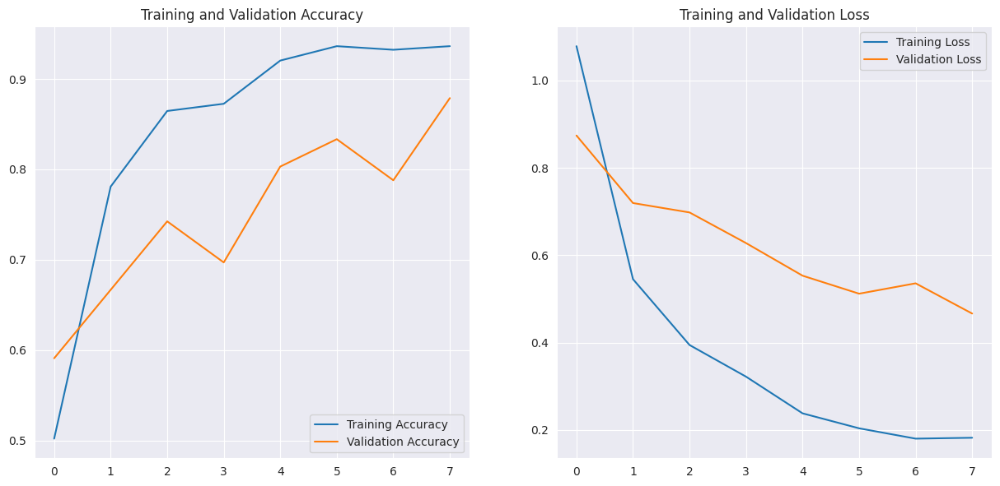

In [ ]:
acc = history['accuracy']
val_acc = history['val_accuracy']
loss = history['loss']
val_loss = history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(15, 15))
plt.subplot(2, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

3/3 [==============================] - 1s 199ms/step
                 precision    recall  f1-score   support

Viral Pneumonia       1.00      0.75      0.86        20
          Covid       0.85      0.88      0.87        26
         Normal       0.83      1.00      0.91        20

       accuracy                           0.88        66
      macro avg       0.90      0.88      0.88        66
   weighted avg       0.89      0.88      0.88        66

                           True  Viral Pneumonia  True  Covid  True  Normal
Predicted Viral Pneumonia                     15            4             1
Predicted Covid                                0           23             3
Predicted Normal                               0            0            20


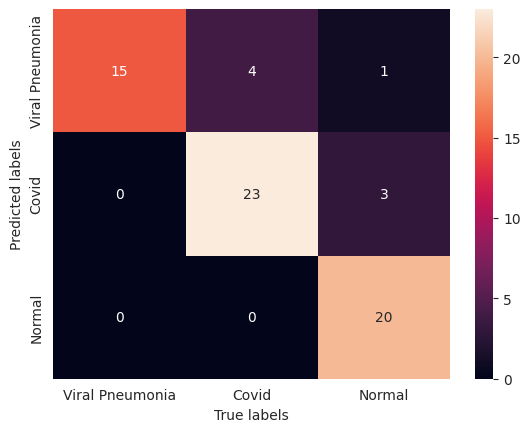

In [ ]:
# Classification report
#predictions = model.predict_classes(x_val)
import numpy as np
predict_x=model.predict(x_val)
predictions=np.argmax(predict_x,axis=1)
predictions = predictions.reshape(1,-1)[0]
print(classification_report(y_val, predictions, target_names = lab.keys()))

# Confusion matrix
cm = pd.DataFrame(confusion_matrix(y_val, predictions))
cm.index = ["Predicted " + s for s in lab.keys()]
cm.columns = ["True  " + s for s in lab.keys()]
print(cm)

sns.heatmap(confusion_matrix(y_val, predictions), annot=True,
            xticklabels = list(lab.keys()), yticklabels = list(lab.keys()))
plt.xlabel("True labels")
plt.ylabel("Predicted labels")
plt.show()

In [ ]:
# Accuracy
predict_x=model.predict(x_train)
predictions=np.argmax(predict_x,axis=1)
z = predictions == y_train
scores_train = sum(z+0)/len(z)
predict_x=model.predict(x_val)
predictions=np.argmax(predict_x,axis=1)

z = predictions == y_val
scores_test = sum(z+0)/len(z)
print('Training DataSet accuracy: {: .1%}'.format(scores_train), 'Test DataSet accuracy: {: .1%}'.format(scores_test))

3/3 [==============================] - 1s 123ms/step
Training DataSet accuracy:  97.2% Test DataSet accuracy:  87.9%


In [ ]:
import numpy as np
import mahotas as mh
from keras.models import model_from_json
import pickle

def diagnosis(file):
    IMM_SIZE = 224  # Replace with your desired size

    # Download image
    ## YOUR CODE GOES HERE ##

    # Initialize image variable
    image = None

    try:
        # Attempt to read the image from the file
        image = mh.imread(file)
    except Exception as e:
        # Print an error message if the image cannot be read
        print(f"Error reading image from {file}: {e}")

    # Check if image is None (i.e., an error occurred during image reading)
    if image is None:
        # Handle the error or return an appropriate value
        return None

    # Prepare image for classification
    ## YOUR CODE GOES HERE ##

    # Check if the image has more than 2 dimensions (i.e., it's RGB or has an alpha channel)
    if len(image.shape) > 2:
        # Resize RGB and PNG images
        image = mh.resize_to(image, [IMM_SIZE, IMM_SIZE, image.shape[2]])
    else:
        # Resize grayscale images
        image = mh.resize_to(image, [IMM_SIZE, IMM_SIZE])

    # Check if the image has more than 2 dimensions (i.e., it's RGB)
    if len(image.shape) > 2:
        # Convert RGB to grayscale and remove alpha channel
        image = mh.colors.rgb2grey(image[:, :, :3], dtype=np.uint8)

    # Load model
    ## YOUR CODE GOES HERE ##

    # Load model architecture from JSON file
    with open('model.json', 'r') as json_file:
        loaded_model_json = json_file.read()

    # Close the JSON file
    model = model_from_json(loaded_model_json)

    # Load weights into the new model
    model.load_weights("model.h5")

    # Load history and lab from pickle files
    with open('history.pickle', 'rb') as f:
        history = pickle.load(f)

    with open('lab.pickle', 'rb') as f:
        lab = pickle.load(f)

    # Normalize the data
    ## YOUR CODE GOES HERE ##
    image = np.array(image) / 255

    # Reshape input images
    ## YOUR CODE GOES HERE ##
    image = image.reshape(-1, IMM_SIZE, IMM_SIZE, 1)

    # Predict the diagnosis
    ## YOUR CODE GOES HERE ##
    predicted_probabilities = model.predict(image)
    diag = np.argmax(predicted_probabilities, axis=-1)

    # Find the name of the diagnosis
    ## YOUR CODE GOES HERE ##
    diag = list(lab.keys())[list(lab.values()).index(diag[0])]

    return diag

In [ ]:
print ("Diagnosis is:", diagnosis("/content/drive/MyDrive/Covid19-dataset/test/Covid/0120.jpg"))
print ("Diagnosis is:", diagnosis("/content/drive/MyDrive/Covid19-dataset/test/Normal/0105.jpeg"))
print ("Diagnosis is:", diagnosis("/content/drive/MyDrive/Covid19-dataset/test/Viral Pneumonia/0111.jpeg"))

1/1 [==============================] - 0s 128ms/step
Diagnosis is: Covid
1/1 [==============================] - 0s 143ms/step
Diagnosis is: Normal
1/1 [==============================] - 0s 154ms/step
Diagnosis is: Viral Pneumonia
